#### Dataloader 


In [1]:
import os
import torch
from torch.utils.data import Dataset
from PIL import Image
from torchvision import transforms
import numpy as np
from cityscapesscripts.helpers.labels import id2label

class CityscapesDataset(Dataset):
    def __init__(self, image_folder, label_folder,augmentation=None):
        self.image_folder = image_folder
        self.label_folder = label_folder
        self.augmentation = augmentation
        
        self.image_paths = sorted([os.path.join(image_folder, x) for x in os.listdir(image_folder) if x.endswith('.png')])
        self.label_paths = sorted([os.path.join(label_folder, x) for x in os.listdir(label_folder) if x.endswith('gtFine_labelIds.png')])

        # Optional check
        assert len(self.image_paths) == len(self.label_paths), "Mismatch between images and labels"

    def __len__(self):
        return len(self.image_paths) 

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image=Image.open(image_path).convert('RGB')
        label=Image.open(label_path)
        label=np.array(label)
        label=self.remap_to_train_id(label)


        if self.augmentation:
            augmented = self.augmentation(image=np.array(image), mask=label)
            image = augmented['image']
            label = augmented['mask']
        
        return image, label

    ## this is a funtion to remap the label id to train id because in cutyscaors dataset there are 34 classses, someof which are not useful 
    ## so by converting them into 19 using Github original repo code of cityscapes dataset
    # cityscapesscripts library
    
    def remap_to_train_id(self, label_np):
        label_train = np.full_like(label_np, 255) 
        
        for id, label in id2label.items():
            if label.trainId != -1:  
                label_train[label_np == id] = label.trainId
        
        label_train[label_train == -1] = 255  

        return label_train

In [2]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_augmentation = A.Compose([
    A.RandomCrop(width=512, height=512),
    A.HorizontalFlip(p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=0.5),
    A.GaussianBlur(blur_limit=(3, 7), p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225),
                max_pixel_value=255.0),
    ToTensorV2()

])

val_augmentation= A.Compose([

    A.Resize(height=512, width=512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225),
                max_pixel_value=255.0),
    ToTensorV2()
])

In [3]:
train_input_dir="/data/Cityscapes/Input/leftImg8bit/train_final"
train_label_dir="/data/Cityscapes/Output/train_final"
val_input_dir="/data/Cityscapes/Input/leftImg8bit/val_final"
val_label_dir="/data/Cityscapes/Output/val_final"
test_input_dir="/data/Cityscapes/Input/leftImg8bit/test_final"
test_label_dir="/data/Cityscapes/Output/test_final"

In [4]:
train_dataset = CityscapesDataset(
    image_folder=train_input_dir,
    label_folder=train_label_dir,
    augmentation=train_augmentation
)
val_dataset = CityscapesDataset(
    image_folder=val_input_dir,
    label_folder=val_label_dir,
    augmentation=val_augmentation
)
test_dataset = CityscapesDataset(
    image_folder=test_input_dir,
    label_folder=test_label_dir,
    augmentation=val_augmentation
)

In [5]:
from torch.utils.data import DataLoader

train_loader = DataLoader(
    train_dataset,
    batch_size=32,
    shuffle=True,
    num_workers=4,
    pin_memory=True
)
val_loader = DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)
test_loader = DataLoader(   
    
        test_dataset,
        batch_size=4,
        shuffle=False,
        num_workers=4,
        pin_memory=True
    )

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6399999].



Visualizing Validation Dataset Samples:
Sample 0:
  Image Shape: torch.Size([3, 512, 512])
  Label Shape: torch.Size([512, 512])


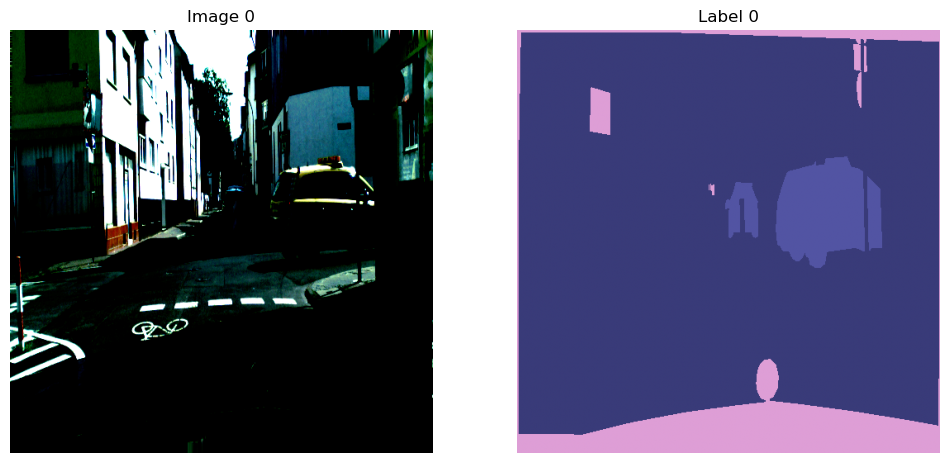

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6399999].


Sample 1:
  Image Shape: torch.Size([3, 512, 512])
  Label Shape: torch.Size([512, 512])


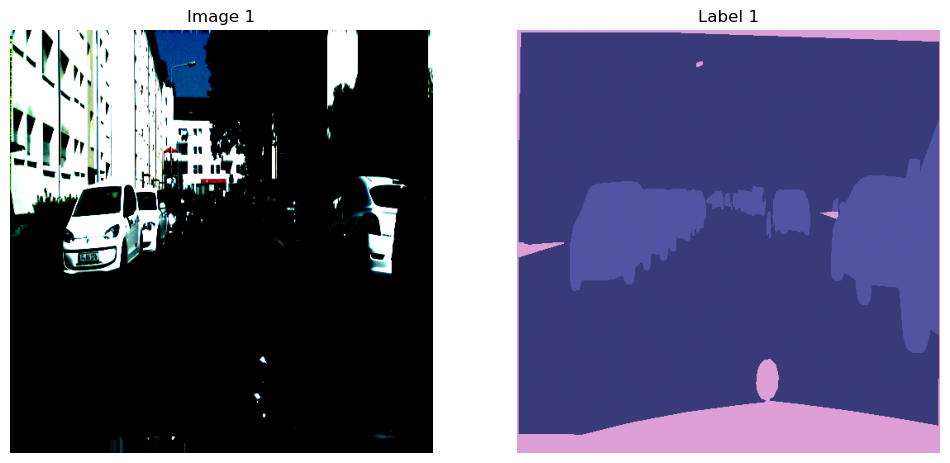

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6399999].


Sample 2:
  Image Shape: torch.Size([3, 512, 512])
  Label Shape: torch.Size([512, 512])


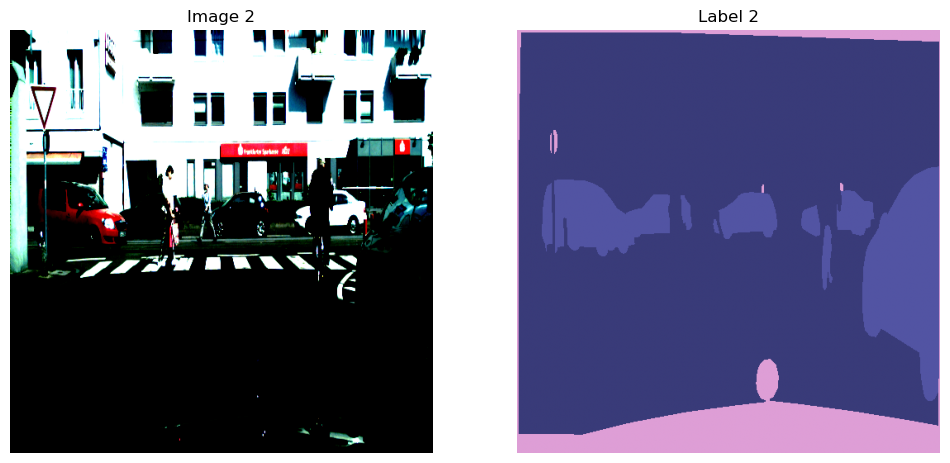

In [6]:
import matplotlib.pyplot as plt

# Function to visualize image and corresponding label
def visualize_sample(image, label, idx):
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    
    # Image
    ax[0].imshow(image)
    ax[0].set_title(f"Image {idx}")
    ax[0].axis('off')
    
    # Label
    ax[1].imshow(label, cmap='tab20b')  # Use 'tab20b' colormap for labels
    ax[1].set_title(f"Label {idx}")
    ax[1].axis('off')
    
    plt.show()

# Verify shapes by iterating through the datasets
def verify_dataset(dataset, num_samples=5):
    for i in range(num_samples):
        image, label = dataset[i]  # Fetch sample
        
        print(f"Sample {i}:")
        print(f"  Image Shape: {image.shape}")
        print(f"  Label Shape: {label.shape}")
        
        visualize_sample(image.permute(1, 2, 0).numpy(), label.numpy(), i)


# Visualize and print shapes for validation dataset
print("\nVisualizing Validation Dataset Samples:")
verify_dataset(val_dataset, num_samples=3)


In [7]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

class ASPPModule(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(ASPPModule, self).__init__()
        
        self.atrousBlock1 = nn.Sequential(

            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.atrousBlock2 = nn.Sequential(

            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=6, dilation=6),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.atrousBlock3 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=12, dilation=12),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()        
        )

        self.atrousBlock4 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=18, dilation=18),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        
        self.imagePooling = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.output = nn.Sequential(
        nn.Conv2d(out_channels * 5, out_channels, kernel_size=1, bias=False),
        nn.BatchNorm2d(out_channels),
        nn.ReLU()
        )

    def forward(self,x):        

        x1=self.atrousBlock1(x)
        x2=self.atrousBlock2(x)
        x3=self.atrousBlock3(x)
        x4=self.atrousBlock4 (x)

        img_pool=F.interpolate(self.imagePooling(x), size=x.shape[2:], mode='bilinear', align_corners=False)

        x=torch.cat([x1,x2,x3,x4,img_pool], dim=1)
        return self.output(x)
    

class Decoder(nn.Module):
    def __init__(self, low_channels, out_channels, num_classes):
        super().__init__()

        self.reduce_low = nn.Sequential(
            nn.Conv2d(low_channels, 48, 1),
            nn.BatchNorm2d(48),
            nn.ReLU()
        )

        self.fuse = nn.Sequential(
            nn.Conv2d(48 + out_channels, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )

        self.classifier = nn.Conv2d(256, num_classes, 1)

    def forward(self, low_feat, high_feat):
        low_feat = self.reduce_low(low_feat)
        high_feat = F.interpolate(high_feat, size=low_feat.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([low_feat, high_feat], dim=1)
        x = self.fuse(x)
        return self.classifier(x)


class MobileNetV2Backbone (nn.Module):
    def __init__(self,low_level_idx=2,high_level_idx=4):
        super().__init__()
        base_model=models.mobilenet_v2(pretrained=True)
        self.low_level_features=base_model.features[:4]
        self.high_level_features=base_model.features[4:]

    def forward (self,x):
        low_feat=self.low_level_features(x)
        high_feat=self.high_level_features(low_feat)

        return low_feat,high_feat
    

class DeepLabV3Plus(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.backbone = MobileNetV2Backbone()
        self.aspp = ASPPModule(in_channels=1280, out_channels=256)
        self.decoder = Decoder(low_channels=24, out_channels=256, num_classes=num_classes)

    def forward(self, x):
        input_size=x.shape[2:]
        low, high = self.backbone(x)
        high = self.aspp(high)
        x = self.decoder(low, high)
        # x = F.interpolate(x, size=(x.shape[2]*4, x.shape[3]*4), mode='bilinear', align_corners=False)
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)

        return x

In [8]:
import torch
from tqdm import tqdm
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

def train_model(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, scheduler=None, save_path="best_model.pth"):
    model.to(device)
    best_val_acc = 0.0  # Track the best validation accuracy

    # Store metrics for plotting
    train_losses = []
    train_accuracies = []
    val_losses = []
    val_accuracies = []

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        total_correct = 0
        total_pixels = 0

        print(f"Epoch [{epoch+1}/{num_epochs}]")

        for images, labels in tqdm(train_loader, desc="Training"):
            images, labels = images.to(device), labels.to(device).long()

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            preds = outputs.argmax(dim=1)
            total_correct += (preds == labels).sum().item()
            total_pixels += torch.numel(labels)

        avg_train_loss = train_loss / len(train_loader)
        train_pixel_acc = total_correct / total_pixels
        train_losses.append(avg_train_loss)
        train_accuracies.append(train_pixel_acc)

        print(f"Train Loss: {avg_train_loss:.4f} | Pixel Acc: {train_pixel_acc:.4f}")

        val_loss, val_acc = evaluate(model, val_loader, criterion, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)

        print(f"Val Loss: {val_loss:.4f} | Val Pixel Acc: {val_acc:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            print(f"Validation accuracy improved! Saving model...")
            torch.save(model.state_dict(), save_path)

        if scheduler:
            scheduler.step()

    print("Training complete!")

    # Plot training and validation curves
    plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies)


def evaluate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0
    total_correct = 0
    total_pixels = 0

    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Validating"):
            images, labels = images.to(device), labels.to(device).long()
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            preds = outputs.argmax(dim=1)
            total_correct += (preds == labels).sum().item()
            total_pixels += torch.numel(labels)

    avg_loss = val_loss / len(val_loader)
    pixel_acc = total_correct / total_pixels

    return avg_loss, pixel_acc


def plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies):
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(12, 5))

    # Loss Plot
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.plot(epochs, val_losses, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss Curve')
    plt.legend()

    # Accuracy Plot
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, label='Train Pixel Acc')
    plt.plot(epochs, val_accuracies, label='Val Pixel Acc')
    plt.xlabel('Epoch')
    plt.ylabel('Pixel Accuracy')
    plt.title('Accuracy Curve')
    plt.legend()

    plt.tight_layout()
    plt.show()


/home/lms-02/miniconda3/envs/sarmad-saleem-env/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/lms-02/miniconda3/envs/sarmad-saleem-env/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch [1/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.06it/s]


Train Loss: 0.8504 | Pixel Acc: 0.7497


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.21it/s]


Val Loss: 0.6582 | Val Pixel Acc: 0.7311
Validation accuracy improved! Saving model...
Epoch [2/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.4844 | Pixel Acc: 0.8130


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.44it/s]


Val Loss: 0.5672 | Val Pixel Acc: 0.7361
Validation accuracy improved! Saving model...
Epoch [3/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.4108 | Pixel Acc: 0.8234


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.53it/s]


Val Loss: 0.4798 | Val Pixel Acc: 0.7506
Validation accuracy improved! Saving model...
Epoch [4/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.3632 | Pixel Acc: 0.8347


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.4387 | Val Pixel Acc: 0.7583
Validation accuracy improved! Saving model...
Epoch [5/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.3304 | Pixel Acc: 0.8417


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.21it/s]


Val Loss: 0.4142 | Val Pixel Acc: 0.7642
Validation accuracy improved! Saving model...
Epoch [6/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.3189 | Pixel Acc: 0.8437


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.15it/s]


Val Loss: 0.4209 | Val Pixel Acc: 0.7591
Epoch [7/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.3008 | Pixel Acc: 0.8473


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.45it/s]


Val Loss: 0.3950 | Val Pixel Acc: 0.7686
Validation accuracy improved! Saving model...
Epoch [8/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.08it/s]


Train Loss: 0.2959 | Pixel Acc: 0.8490


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.37it/s]


Val Loss: 0.3915 | Val Pixel Acc: 0.7684
Epoch [9/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.08it/s]


Train Loss: 0.2828 | Pixel Acc: 0.8517


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.38it/s]


Val Loss: 0.3781 | Val Pixel Acc: 0.7721
Validation accuracy improved! Saving model...
Epoch [10/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.2783 | Pixel Acc: 0.8539


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.07it/s]


Val Loss: 0.3605 | Val Pixel Acc: 0.7766
Validation accuracy improved! Saving model...
Epoch [11/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.08it/s]


Train Loss: 0.2665 | Pixel Acc: 0.8546


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.38it/s]


Val Loss: 0.3513 | Val Pixel Acc: 0.7784
Validation accuracy improved! Saving model...
Epoch [12/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.2614 | Pixel Acc: 0.8566


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.41it/s]


Val Loss: 0.3520 | Val Pixel Acc: 0.7787
Validation accuracy improved! Saving model...
Epoch [13/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2519 | Pixel Acc: 0.8613


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.35it/s]


Val Loss: 0.3589 | Val Pixel Acc: 0.7759
Epoch [14/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.2535 | Pixel Acc: 0.8566


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.32it/s]


Val Loss: 0.3506 | Val Pixel Acc: 0.7773
Epoch [15/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.06it/s]


Train Loss: 0.2439 | Pixel Acc: 0.8616


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.39it/s]


Val Loss: 0.3592 | Val Pixel Acc: 0.7741
Epoch [16/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.06it/s]


Train Loss: 0.2421 | Pixel Acc: 0.8629


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.42it/s]


Val Loss: 0.3624 | Val Pixel Acc: 0.7752
Epoch [17/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2356 | Pixel Acc: 0.8645


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.37it/s]


Val Loss: 0.3571 | Val Pixel Acc: 0.7762
Epoch [18/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2352 | Pixel Acc: 0.8625


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.48it/s]


Val Loss: 0.3507 | Val Pixel Acc: 0.7788
Validation accuracy improved! Saving model...
Epoch [19/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2346 | Pixel Acc: 0.8647


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.26it/s]


Val Loss: 0.3571 | Val Pixel Acc: 0.7764
Epoch [20/20]


Training: 100%|█████████████████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.2278 | Pixel Acc: 0.8653


Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.26it/s]


Val Loss: 0.3213 | Val Pixel Acc: 0.7858
Validation accuracy improved! Saving model...
Training complete!


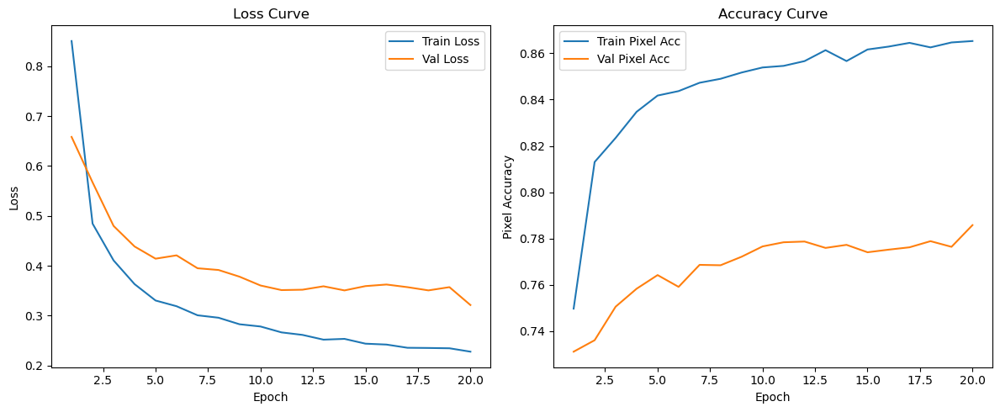

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = DeepLabV3Plus(num_classes=19)  
criterion = nn.CrossEntropyLoss(ignore_index=255)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)

train_model(model, train_loader, val_loader, num_epochs=20,
            criterion=criterion, optimizer=optimizer, device=device)


In [10]:
avg_loss,pixel_acc=evaluate(model,val_loader,criterion, device)

print("Average Loss ",avg_loss)
print("Pixel Accu",pixel_acc)



Validating: 100%|█████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.52it/s]

Average Loss  0.32129545211791993
Pixel Accu 0.7857778625488281


In [11]:
model = DeepLabV3Plus(num_classes=19)
model.load_state_dict(torch.load("best_model.pth", map_location=device))
model.to(device)
model.eval()


DeepLabV3Plus(
  (backbone): MobileNetV2Backbone(
    (low_level_features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (1): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU6(inplace=True)
          )
          (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (2): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(1

In [12]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from matplotlib.colors import ListedColormap

# Simple colormap for 19 classes (you can customize it)
def get_colormap():
    base_colors = plt.cm.tab20b(np.linspace(0, 1, 20))
    return ListedColormap(base_colors[:19])

def visualize_predictions(model, dataloader, device, num_samples=5):
    cmap = get_colormap()
    model.eval()

    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            if i >= num_samples:
                break

            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            preds = outputs.argmax(dim=1)

            for j in range(images.size(0)):
                img = images[j].cpu().permute(1, 2, 0).numpy()
                img = (img * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406]  # unnormalize
                img = np.clip(img, 0, 1)

                label = labels[j].cpu().numpy()
                pred = preds[j].cpu().numpy()

                fig, axs = plt.subplots(1, 3, figsize=(18, 6))
                axs[0].imshow(img)
                axs[0].set_title("Input Image")
                axs[0].axis("off")

                axs[1].imshow(label, cmap=cmap, vmin=0, vmax=18)
                axs[1].set_title("Ground Truth")
                axs[1].axis("off")

                axs[2].imshow(pred, cmap=cmap, vmin=0, vmax=18)
                axs[2].set_title("Predicted Mask")
                axs[2].axis("off")

                plt.tight_layout()
                plt.show()


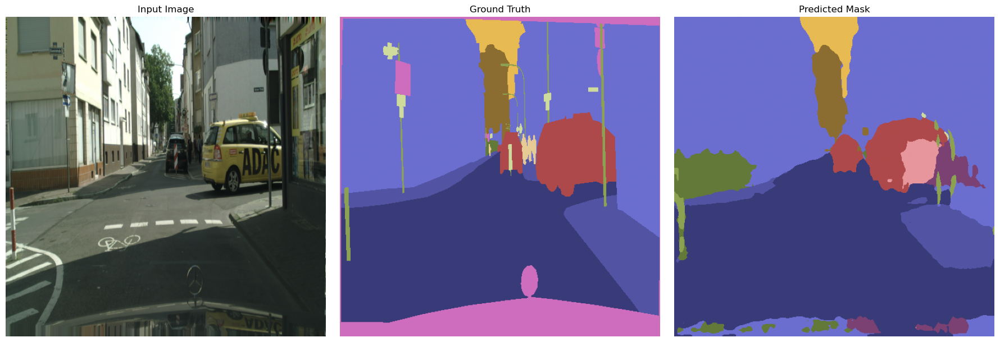

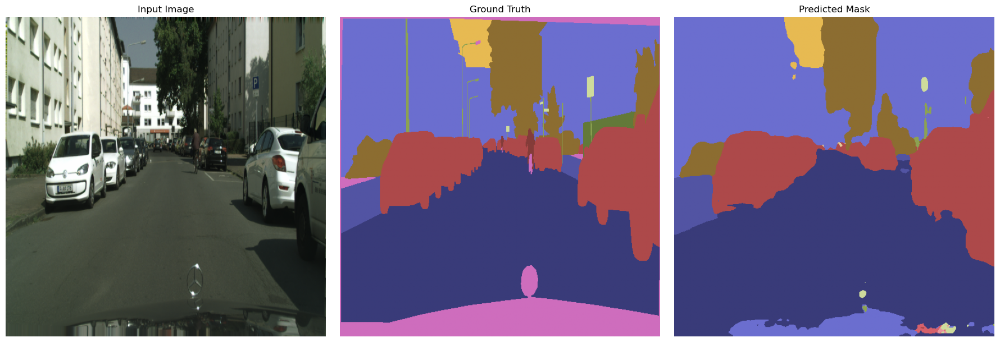

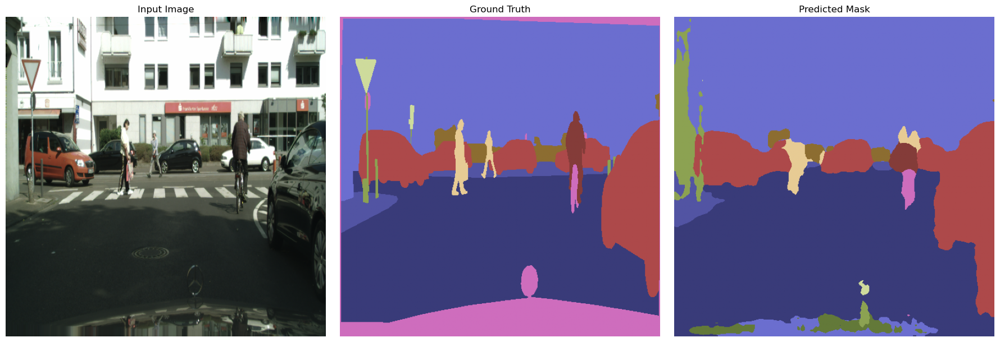

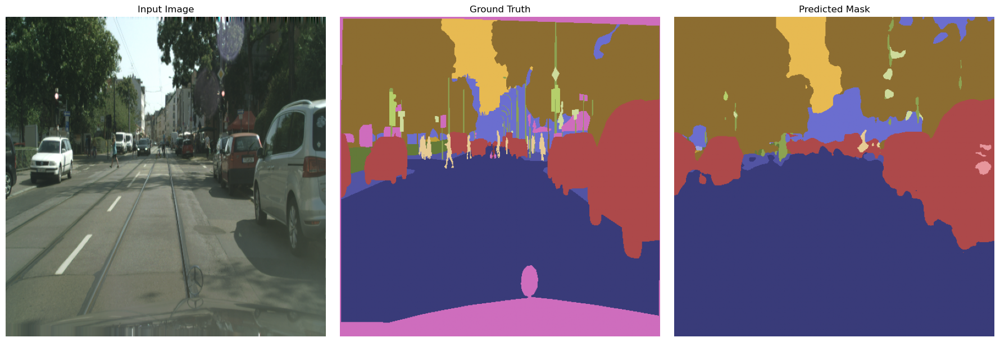

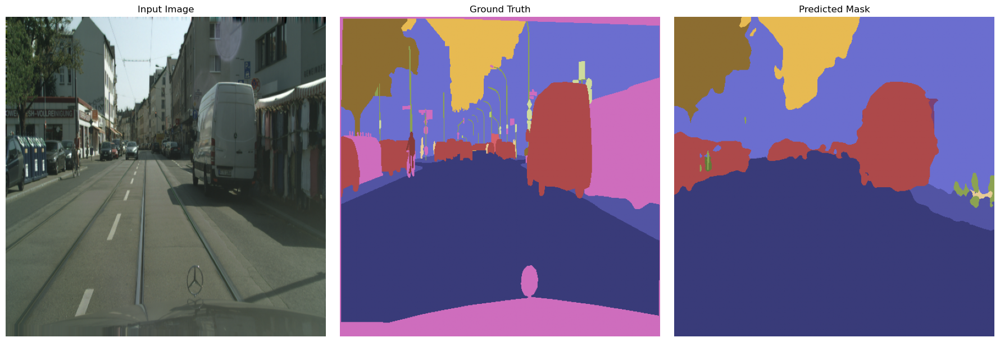

...

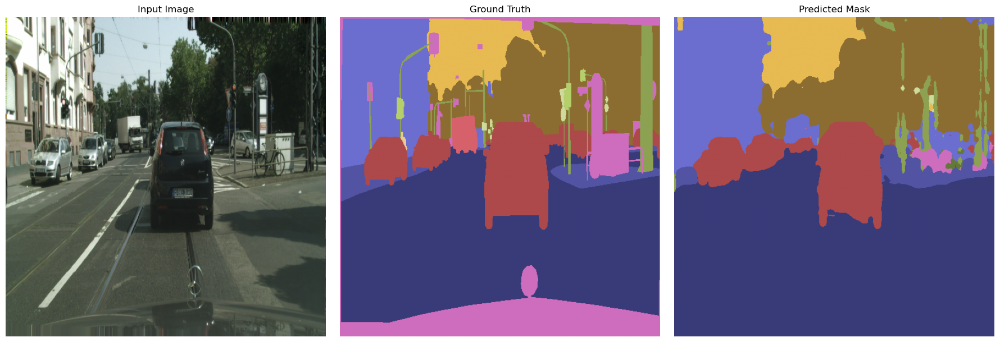

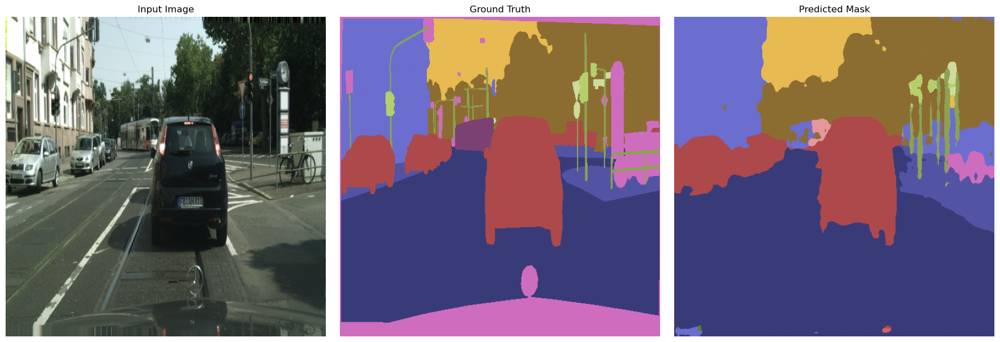

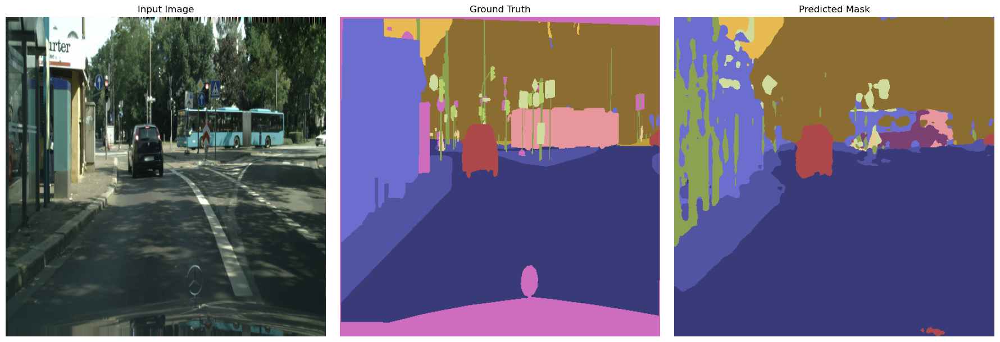

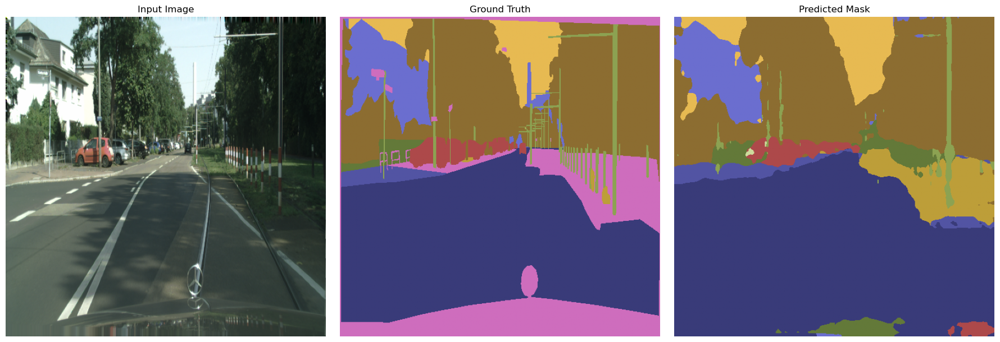

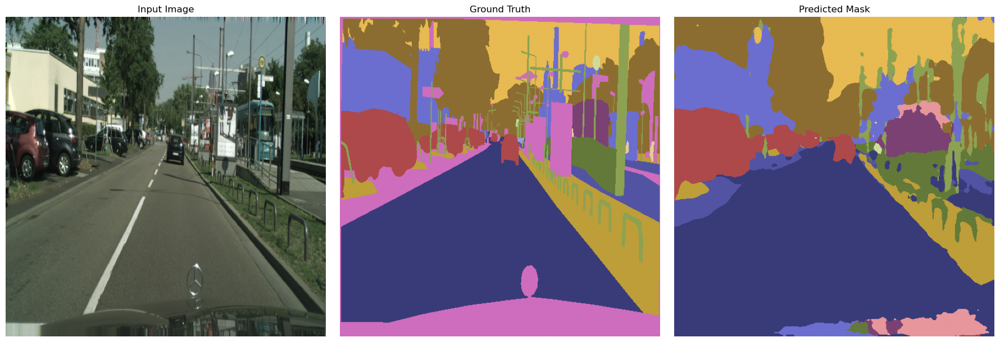

In [13]:
visualize_predictions(model, val_loader, device, num_samples=3)


In [7]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

class ASPPModule(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ASPPModule, self).__init__()
        
        self.atrousBlock1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.atrousBlock2 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=6, dilation=6),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.atrousBlock3 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=12, dilation=12),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()        
        )

        self.atrousBlock4 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=18, dilation=18),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        
        self.imagePooling = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.output = nn.Sequential(
            nn.Conv2d(out_channels * 5, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):        
        x1 = self.atrousBlock1(x)
        x2 = self.atrousBlock2(x)
        x3 = self.atrousBlock3(x)
        x4 = self.atrousBlock4(x)

        img_pool = F.interpolate(self.imagePooling(x), size=x.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([x1, x2, x3, x4, img_pool], dim=1)
        return self.output(x)

class SKFusion(nn.Module):
    def __init__(self, in_channels, reduction=16):
        super(SKFusion, self).__init__()
        self.in_channels = in_channels

        # Split: Two convolution paths with different kernel sizes (3x3 and 5x5)
        self.conv_3x3 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)
        self.conv_5x5 = nn.Conv2d(in_channels, in_channels, kernel_size=5, padding=2)

        # Fuse: Global average pooling and fully connected layers
        self.global_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Linear(in_channels, in_channels // reduction)
        self.fc2 = nn.Linear(in_channels // reduction, in_channels * 2)  # For two branches (3x3 and 5x5)

    def forward(self, x):
        # Split
        u1 = self.conv_3x3(x)  # 3x3 convolution
        u2 = self.conv_5x5(x)  # 5x5 convolution

        # Fuse: Element-wise summation
        u = u1 + u2

        # Global average pooling
        s = self.global_pool(u).view(-1, self.in_channels)

        # Fully connected layers to compute attention weights
        z = F.relu(self.fc1(s))
        a_b = self.fc2(z)  # Shape: (batch_size, in_channels * 2)

        # Reshape and softmax to get weights for each branch
        a_b = a_b.view(-1, 2, self.in_channels)  # (batch_size, 2, in_channels)
        a_b = F.softmax(a_b, dim=1)  # Softmax over the branch dimension

        # Select: Compute weighted sum of features
        a, b = a_b[:, 0, :], a_b[:, 1, :]  # Weights for 3x3 and 5x5
        a = a.view(-1, self.in_channels, 1, 1)  # Reshape for broadcasting
        b = b.view(-1, self.in_channels, 1, 1)

        v = a * u1 + b * u2  # Weighted combination of features
        return v

class Decoder(nn.Module):
    def __init__(self, low_channels, out_channels, num_classes):
        super().__init__()

        self.reduce_low = nn.Sequential(
            nn.Conv2d(low_channels, 48, 1),
            nn.BatchNorm2d(48),
            nn.ReLU()
        )

        # SKFusion after concatenation of low and high features
        self.skfusion = SKFusion(in_channels=48 + out_channels)

        self.fuse = nn.Sequential(
            nn.Conv2d(48 + out_channels, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )

        self.classifier = nn.Conv2d(256, num_classes, 1)

    def forward(self, low_feat, high_feat):
        low_feat = self.reduce_low(low_feat)
        high_feat = F.interpolate(high_feat, size=low_feat.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([low_feat, high_feat], dim=1)
        x = self.skfusion(x)  # Apply SKFusion attention
        x = self.fuse(x)
        return self.classifier(x)

class MobileNetV2Backbone(nn.Module):
    def __init__(self, low_level_idx=2, high_level_idx=4):
        super().__init__()
        base_model = models.mobilenet_v2(pretrained=True)
        self.low_level_features = base_model.features[:4]
        self.high_level_features = base_model.features[4:]

    def forward(self, x):
        low_feat = self.low_level_features(x)
        high_feat = self.high_level_features(low_feat)
        return low_feat, high_feat

class DeepLabV3Plus(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.backbone = MobileNetV2Backbone()
        self.aspp = ASPPModule(in_channels=1280, out_channels=256)
        self.decoder = Decoder(low_channels=24, out_channels=256, num_classes=num_classes)

    def forward(self, x):
        input_size = x.shape[2:]
        low, high = self.backbone(x)
        high = self.aspp(high)
        x = self.decoder(low, high)
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)
        return x

In [8]:
import torch
from tqdm import tqdm
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

def train_model(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, scheduler=None, save_path="attention-model.pth"):
    model.to(device)
    best_val_acc = 0.0  # Track the best validation accuracy

    # Store metrics for plotting
    train_losses = []
    train_accuracies = []
    val_losses = []
    val_accuracies = []

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        total_correct = 0
        total_pixels = 0

        print(f"Epoch [{epoch+1}/{num_epochs}]")

        for images, labels in tqdm(train_loader, desc="Training"):
            images, labels = images.to(device), labels.to(device).long()

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            preds = outputs.argmax(dim=1)
            total_correct += (preds == labels).sum().item()
            total_pixels += torch.numel(labels)

        avg_train_loss = train_loss / len(train_loader)
        train_pixel_acc = total_correct / total_pixels
        train_losses.append(avg_train_loss)
        train_accuracies.append(train_pixel_acc)

        print(f"Train Loss: {avg_train_loss:.4f} | Pixel Acc: {train_pixel_acc:.4f}")

        val_loss, val_acc = evaluate(model, val_loader, criterion, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)

        print(f"Val Loss: {val_loss:.4f} | Val Pixel Acc: {val_acc:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            print(f"Validation accuracy improved! Saving model...")
            torch.save(model.state_dict(), save_path)

        if scheduler:
            scheduler.step()

    print("Training complete!")

    # Plot training and validation curves
    plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies)


def evaluate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0
    total_correct = 0
    total_pixels = 0

    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Validating"):
            images, labels = images.to(device), labels.to(device).long()
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            preds = outputs.argmax(dim=1)
            total_correct += (preds == labels).sum().item()
            total_pixels += torch.numel(labels)

    avg_loss = val_loss / len(val_loader)
    pixel_acc = total_correct / total_pixels

    return avg_loss, pixel_acc


def plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies):
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(12, 5))

    # Loss Plot
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.plot(epochs, val_losses, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss Curve')
    plt.legend()

    # Accuracy Plot
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, label='Train Pixel Acc')
    plt.plot(epochs, val_accuracies, label='Val Pixel Acc')
    plt.xlabel('Epoch')
    plt.ylabel('Pixel Accuracy')
    plt.title('Accuracy Curve')
    plt.legend()

    plt.tight_layout()
    plt.show()


Epoch [1/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.8513 | Pixel Acc: 0.7558


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.38it/s]


Val Loss: 0.6847 | Val Pixel Acc: 0.7209
Validation accuracy improved! Saving model...
Epoch [2/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.5078 | Pixel Acc: 0.8134


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.28it/s]


Val Loss: 0.5190 | Val Pixel Acc: 0.7519
Validation accuracy improved! Saving model...
Epoch [3/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.4162 | Pixel Acc: 0.8289


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.19it/s]


Val Loss: 0.4725 | Val Pixel Acc: 0.7557
Validation accuracy improved! Saving model...
Epoch [4/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.3785 | Pixel Acc: 0.8351


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.38it/s]


Val Loss: 0.4288 | Val Pixel Acc: 0.7624
Validation accuracy improved! Saving model...
Epoch [5/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.3463 | Pixel Acc: 0.8395


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.4189 | Val Pixel Acc: 0.7641
Validation accuracy improved! Saving model...
Epoch [6/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.3419 | Pixel Acc: 0.8411


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.11it/s]


Val Loss: 0.4170 | Val Pixel Acc: 0.7642
Validation accuracy improved! Saving model...
Epoch [7/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.3164 | Pixel Acc: 0.8482


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.48it/s]


Val Loss: 0.4020 | Val Pixel Acc: 0.7689
Validation accuracy improved! Saving model...
Epoch [8/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.2879 | Pixel Acc: 0.8565


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.13it/s]


Val Loss: 0.3906 | Val Pixel Acc: 0.7696
Validation accuracy improved! Saving model...
Epoch [9/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.06it/s]


Train Loss: 0.2945 | Pixel Acc: 0.8534


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.19it/s]


Val Loss: 0.3752 | Val Pixel Acc: 0.7745
Validation accuracy improved! Saving model...
Epoch [10/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.2852 | Pixel Acc: 0.8561


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.19it/s]


Val Loss: 0.3851 | Val Pixel Acc: 0.7707
Epoch [11/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.2821 | Pixel Acc: 0.8559


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.39it/s]


Val Loss: 0.3846 | Val Pixel Acc: 0.7703
Epoch [12/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.2644 | Pixel Acc: 0.8617


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.16it/s]


Val Loss: 0.3624 | Val Pixel Acc: 0.7762
Validation accuracy improved! Saving model...
Epoch [13/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.2594 | Pixel Acc: 0.8612


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.38it/s]


Val Loss: 0.3784 | Val Pixel Acc: 0.7727
Epoch [14/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.06it/s]


Train Loss: 0.2513 | Pixel Acc: 0.8625


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.23it/s]


Val Loss: 0.3616 | Val Pixel Acc: 0.7762
Validation accuracy improved! Saving model...
Epoch [15/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.2467 | Pixel Acc: 0.8625


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.16it/s]


Val Loss: 0.3455 | Val Pixel Acc: 0.7803
Validation accuracy improved! Saving model...
Epoch [16/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.2488 | Pixel Acc: 0.8662


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.17it/s]


Val Loss: 0.3650 | Val Pixel Acc: 0.7758
Epoch [17/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2543 | Pixel Acc: 0.8604


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.12it/s]


Val Loss: 0.3523 | Val Pixel Acc: 0.7778
Epoch [18/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.08it/s]


Train Loss: 0.2386 | Pixel Acc: 0.8681


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.3573 | Val Pixel Acc: 0.7770
Epoch [19/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.2336 | Pixel Acc: 0.8688


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.3383 | Val Pixel Acc: 0.7818
Validation accuracy improved! Saving model...
Epoch [20/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.2335 | Pixel Acc: 0.8672


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.3429 | Val Pixel Acc: 0.7813
Epoch [21/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.2272 | Pixel Acc: 0.8715


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.26it/s]


Val Loss: 0.3431 | Val Pixel Acc: 0.7808
Epoch [22/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.06it/s]


Train Loss: 0.2302 | Pixel Acc: 0.8691


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.17it/s]


Val Loss: 0.3416 | Val Pixel Acc: 0.7802
Epoch [23/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.2193 | Pixel Acc: 0.8707


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.22it/s]


Val Loss: 0.3300 | Val Pixel Acc: 0.7846
Validation accuracy improved! Saving model...
Epoch [24/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.06it/s]


Train Loss: 0.2130 | Pixel Acc: 0.8745


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.20it/s]


Val Loss: 0.3425 | Val Pixel Acc: 0.7829
Epoch [25/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2157 | Pixel Acc: 0.8725


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.16it/s]


Val Loss: 0.3110 | Val Pixel Acc: 0.7884
Validation accuracy improved! Saving model...
Epoch [26/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.2164 | Pixel Acc: 0.8732


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.13it/s]


Val Loss: 0.3146 | Val Pixel Acc: 0.7878
Epoch [27/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.06it/s]


Train Loss: 0.2081 | Pixel Acc: 0.8750


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.3141 | Val Pixel Acc: 0.7882
Epoch [28/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.2096 | Pixel Acc: 0.8758


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.10it/s]


Val Loss: 0.3195 | Val Pixel Acc: 0.7867
Epoch [29/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.2049 | Pixel Acc: 0.8754


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.19it/s]


Val Loss: 0.3297 | Val Pixel Acc: 0.7835
Epoch [30/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.06it/s]


Train Loss: 0.2083 | Pixel Acc: 0.8754


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.08it/s]


Val Loss: 0.3139 | Val Pixel Acc: 0.7875
Epoch [31/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.2066 | Pixel Acc: 0.8754


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.21it/s]


Val Loss: 0.3280 | Val Pixel Acc: 0.7824
Epoch [32/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.2064 | Pixel Acc: 0.8771


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.23it/s]


Val Loss: 0.3184 | Val Pixel Acc: 0.7883
Epoch [33/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.2054 | Pixel Acc: 0.8762


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.21it/s]


Val Loss: 0.3181 | Val Pixel Acc: 0.7864
Epoch [34/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.2043 | Pixel Acc: 0.8767


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.31it/s]


Val Loss: 0.3269 | Val Pixel Acc: 0.7833
Epoch [35/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.2007 | Pixel Acc: 0.8773


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.15it/s]


Val Loss: 0.3200 | Val Pixel Acc: 0.7862
Epoch [36/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.2020 | Pixel Acc: 0.8754


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.29it/s]


Val Loss: 0.3060 | Val Pixel Acc: 0.7904
Validation accuracy improved! Saving model...
Epoch [37/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.2034 | Pixel Acc: 0.8755


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.48it/s]


Val Loss: 0.3066 | Val Pixel Acc: 0.7893
Epoch [38/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.1925 | Pixel Acc: 0.8802


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.19it/s]


Val Loss: 0.3188 | Val Pixel Acc: 0.7862
Epoch [39/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1970 | Pixel Acc: 0.8784


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.40it/s]


Val Loss: 0.3236 | Val Pixel Acc: 0.7854
Epoch [40/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1933 | Pixel Acc: 0.8804


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.19it/s]


Val Loss: 0.3044 | Val Pixel Acc: 0.7894
Epoch [41/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.1895 | Pixel Acc: 0.8806


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.17it/s]


Val Loss: 0.2947 | Val Pixel Acc: 0.7921
Validation accuracy improved! Saving model...
Epoch [42/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1871 | Pixel Acc: 0.8798


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.48it/s]


Val Loss: 0.3074 | Val Pixel Acc: 0.7888
Epoch [43/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1816 | Pixel Acc: 0.8853


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.21it/s]


Val Loss: 0.3097 | Val Pixel Acc: 0.7864
Epoch [44/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1866 | Pixel Acc: 0.8782


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.22it/s]


Val Loss: 0.3139 | Val Pixel Acc: 0.7879
Epoch [45/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:27<00:00,  1.07it/s]


Train Loss: 0.1913 | Pixel Acc: 0.8810


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.20it/s]


Val Loss: 0.3262 | Val Pixel Acc: 0.7853
Epoch [46/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.08it/s]


Train Loss: 0.1896 | Pixel Acc: 0.8784


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.41it/s]


Val Loss: 0.3062 | Val Pixel Acc: 0.7880
Epoch [47/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1814 | Pixel Acc: 0.8816


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.40it/s]


Val Loss: 0.3082 | Val Pixel Acc: 0.7886
Epoch [48/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.1798 | Pixel Acc: 0.8838


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.33it/s]


Val Loss: 0.3136 | Val Pixel Acc: 0.7879
Epoch [49/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.1788 | Pixel Acc: 0.8828


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.03it/s]


Val Loss: 0.3230 | Val Pixel Acc: 0.7854
Epoch [50/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.1802 | Pixel Acc: 0.8824


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.09it/s]


Val Loss: 0.3146 | Val Pixel Acc: 0.7873
Epoch [51/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.1833 | Pixel Acc: 0.8820


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.16it/s]


Val Loss: 0.2968 | Val Pixel Acc: 0.7918
Epoch [52/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.1754 | Pixel Acc: 0.8860


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.32it/s]


Val Loss: 0.3148 | Val Pixel Acc: 0.7871
Epoch [53/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.1800 | Pixel Acc: 0.8828


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.27it/s]


Val Loss: 0.3228 | Val Pixel Acc: 0.7864
Epoch [54/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.1807 | Pixel Acc: 0.8828


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.30it/s]


Val Loss: 0.2966 | Val Pixel Acc: 0.7926
Validation accuracy improved! Saving model...
Epoch [55/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:28<00:00,  1.05it/s]


Train Loss: 0.1790 | Pixel Acc: 0.8809


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.14it/s]


Val Loss: 0.2951 | Val Pixel Acc: 0.7920
Epoch [56/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.09it/s]


Train Loss: 0.1767 | Pixel Acc: 0.8816


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.42it/s]


Val Loss: 0.2916 | Val Pixel Acc: 0.7927
Validation accuracy improved! Saving model...
Epoch [57/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:25<00:00,  1.08it/s]


Train Loss: 0.1707 | Pixel Acc: 0.8864


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  7.97it/s]


Val Loss: 0.3007 | Val Pixel Acc: 0.7907
Epoch [58/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.07it/s]


Train Loss: 0.1741 | Pixel Acc: 0.8840


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.10it/s]


Val Loss: 0.2963 | Val Pixel Acc: 0.7920
Epoch [59/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:26<00:00,  1.08it/s]


Train Loss: 0.1717 | Pixel Acc: 0.8855


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.41it/s]


Val Loss: 0.2973 | Val Pixel Acc: 0.7915
Epoch [60/60]


Training: 100%|███████████████████████████████████████████████████████████████| 93/93 [01:29<00:00,  1.04it/s]


Train Loss: 0.1730 | Pixel Acc: 0.8859


Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.16it/s]


Val Loss: 0.3053 | Val Pixel Acc: 0.7892
Training complete!


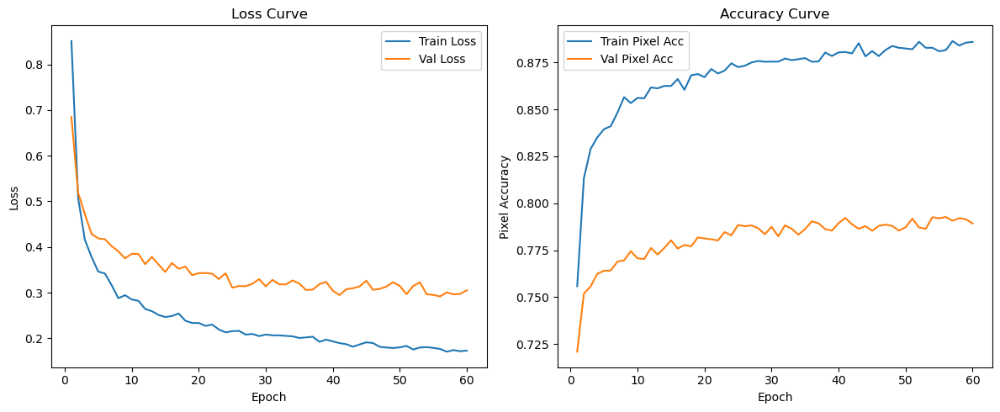

In [10]:
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")

model = DeepLabV3Plus(num_classes=19)  
criterion = nn.CrossEntropyLoss(ignore_index=255)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)

train_model(model, train_loader, val_loader, num_epochs=60,
            criterion=criterion, optimizer=optimizer, device=device, save_path='attention-model.pth')

In [11]:
avg_loss,pixel_acc=evaluate(model,val_loader,criterion, device)

print("Average Loss ",avg_loss)
print("Pixel Accu",pixel_acc)

Validating: 100%|███████████████████████████████████████████████████████████| 125/125 [00:15<00:00,  8.02it/s]

Average Loss  0.35628673183917997
Pixel Accu 0.7769836883544922


In [1]:
model = DeepLabV3Plus(num_classes=19)
model.load_state_dict(torch.load("attention-model.pth", map_location=device))
model.to(device)
model.eval()

NameError: name 'DeepLabV3Plus' is not defined

In [13]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from matplotlib.colors import ListedColormap

# Simple colormap for 19 classes (you can customize it)
def get_colormap():
    base_colors = plt.cm.tab20b(np.linspace(0, 1, 20))
    return ListedColormap(base_colors[:19])

def visualize_predictions(model, dataloader, device, num_samples=5):
    cmap = get_colormap()
    model.eval()

    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            if i >= num_samples:
                break

            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            preds = outputs.argmax(dim=1)

            for j in range(images.size(0)):
                img = images[j].cpu().permute(1, 2, 0).numpy()
                img = (img * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406]  # unnormalize
                img = np.clip(img, 0, 1)

                label = labels[j].cpu().numpy()
                pred = preds[j].cpu().numpy()

                fig, axs = plt.subplots(1, 3, figsize=(18, 6))
                axs[0].imshow(img)
                axs[0].set_title("Input Image")
                axs[0].axis("off")

                axs[1].imshow(label, cmap=cmap, vmin=0, vmax=18)
                axs[1].set_title("Ground Truth")
                axs[1].axis("off")

                axs[2].imshow(pred, cmap=cmap, vmin=0, vmax=18)
                axs[2].set_title("Predicted Mask")
                axs[2].axis("off")

                plt.tight_layout()
                plt.show()

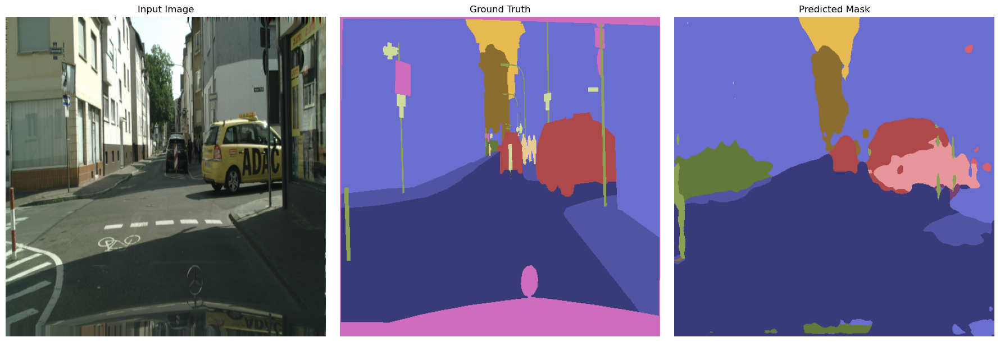

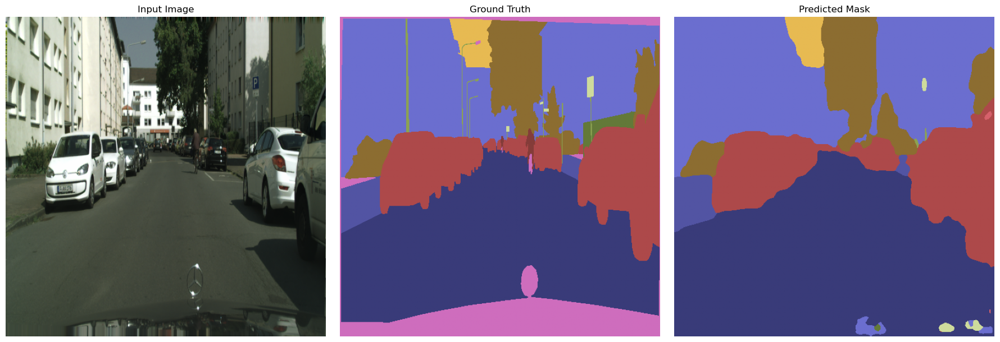

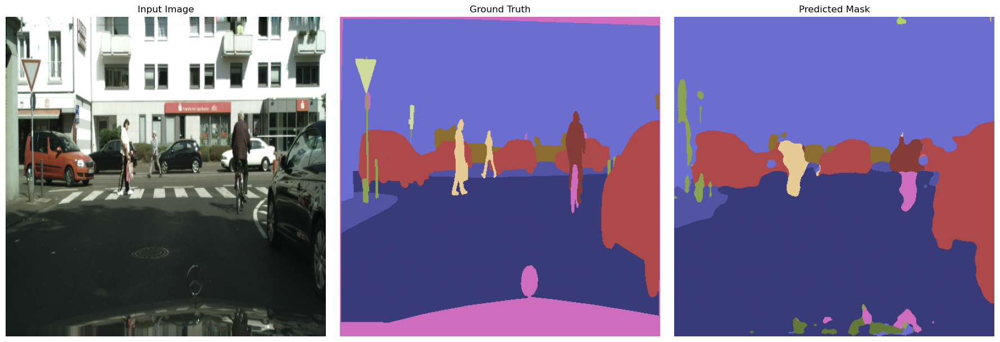

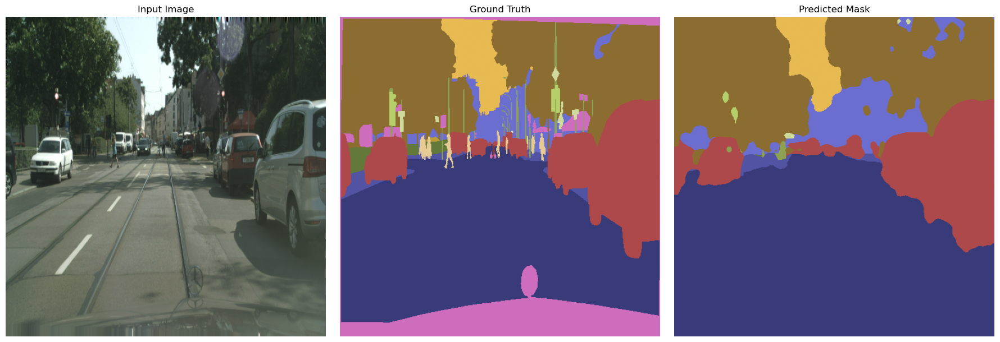

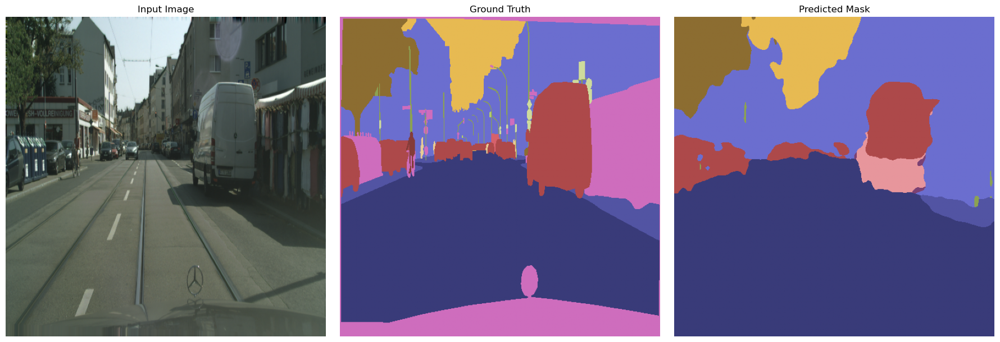

...

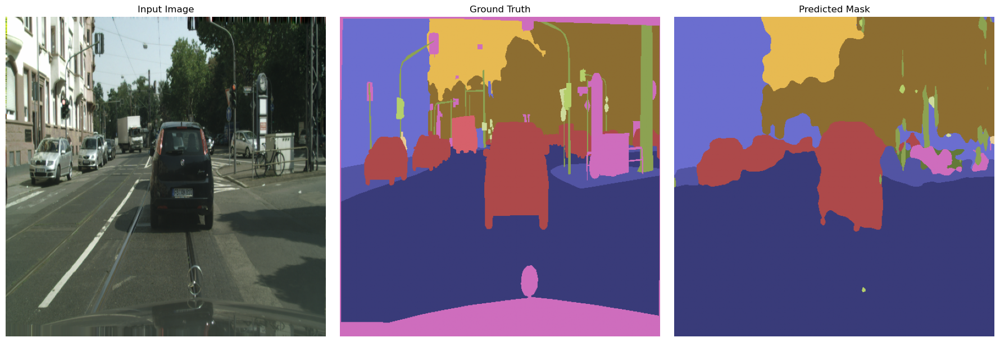

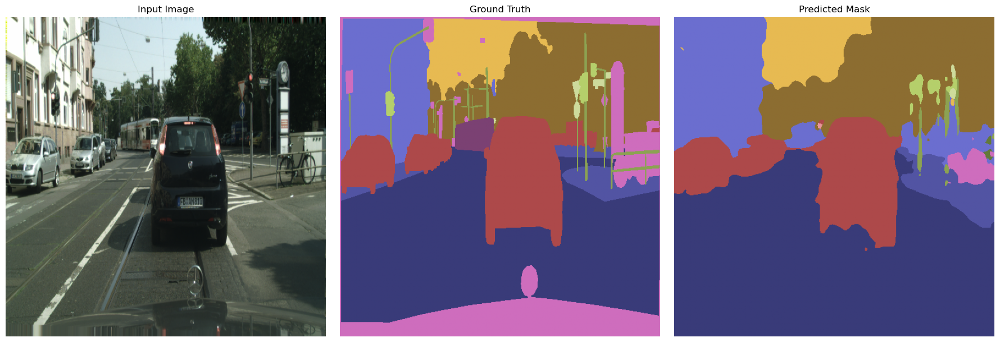

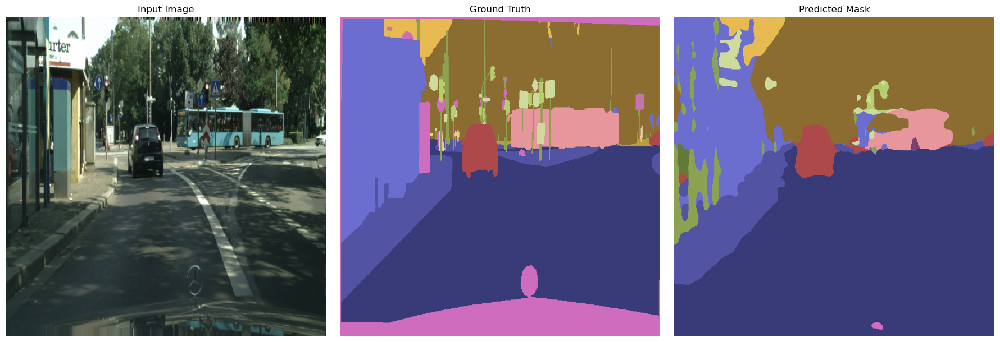

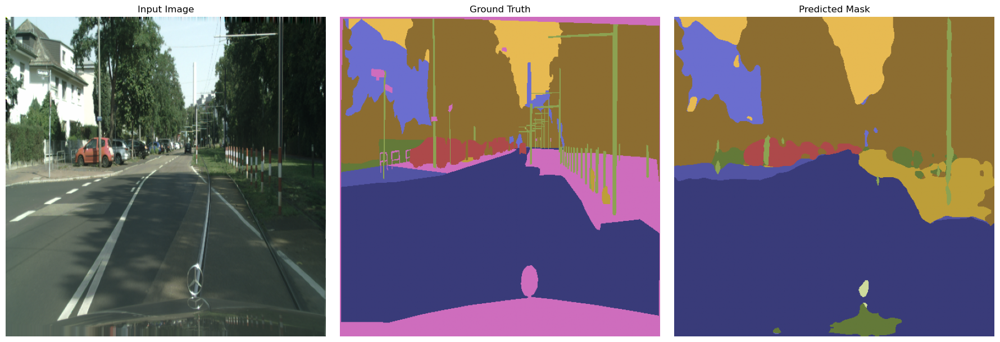

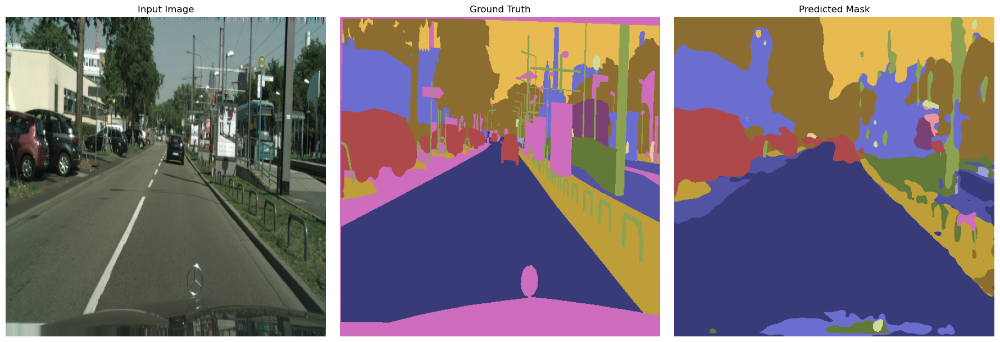

In [14]:
visualize_predictions(model, val_loader, device, num_samples=3)